In [0]:
import cv2
from glob import glob
import matplotlib.pyplot as plt
import numpy as np
import os 
import pandas as pd

In [0]:
from google.colab import drive
drive.mount('/content/drive')

Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3aietf%3awg%3aoauth%3a2.0%3aoob&response_type=code&scope=email%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdocs.test%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive.photos.readonly%20https%3a%2f%2fwww.googleapis.com%2fauth%2fpeopleapi.readonly

Enter your authorization code:
··········
Mounted at /content/drive


In [0]:
!mkdir data

mkdir: cannot create directory ‘data’: File exists


In [0]:
!cp drive/My\ Drive/Colab/carla/carladrivingautopilot.zip data/

In [0]:
!unzip -q data/carladrivingautopilot.zip

In [0]:
!unzip -q data/carladrivingautopilot.zip -d data/

In [0]:
filenames = glob('data/*.png')

In [0]:
test_images_RGB = []
nb_images = len(filenames)
for i in range(nb_images):
    image = cv2.imread(filenames[i])
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    test_images_RGB.append(image)

In [0]:
test_images_HSV = list(map(lambda img: cv2.cvtColor(img, cv2.COLOR_RGB2HSV), 
                           test_images_RGB))

In [0]:
test_images = [(img_rgb, img_hsv[:,:,0], img_hsv[:,:,1], img_hsv[:,:,2]) 
               for (img_rgb, img_hsv) in zip(test_images_RGB, test_images_HSV)]

In [0]:
test_images = [ img for tup in test_images for img in tup]

In [0]:
def plot_img_grid(images, nb_cols):
    nb_images = len(images)
    nb_rows = int(np.ceil(nb_images/nb_cols))
    
    for i in range(nb_rows):
        plt.figure(figsize=(32, 4))
        for j in range(nb_cols):
            plt.subplot(1, nb_cols, j+1)
            image = images[i*nb_cols + j]
            nb_channels = 1 if len(image.shape) == 2 else image.shape[-1]
            plt.imshow(image, cmap='gray' if nb_channels == 1 else None)
            plt.xticks([])
            plt.yticks([])
        plt.show()

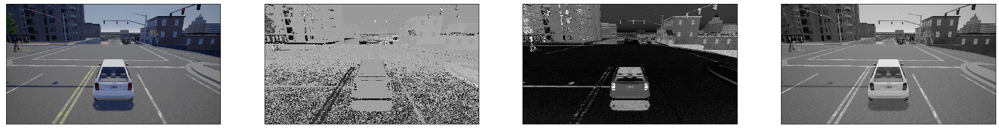

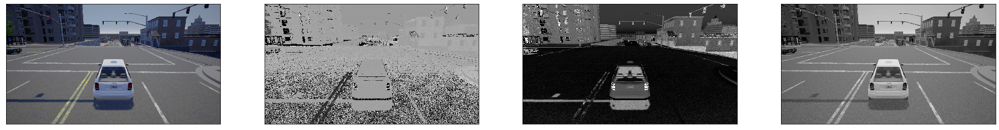

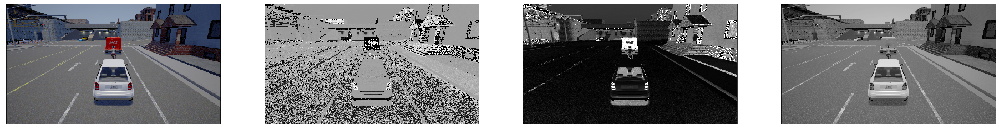

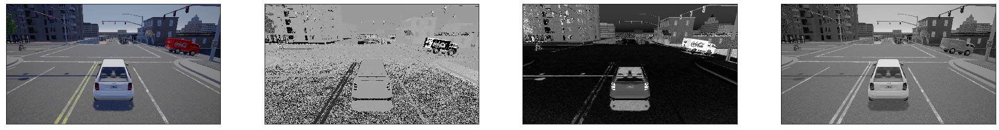

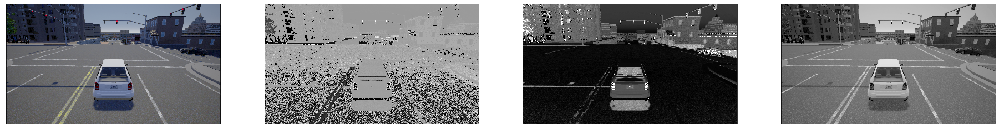

...

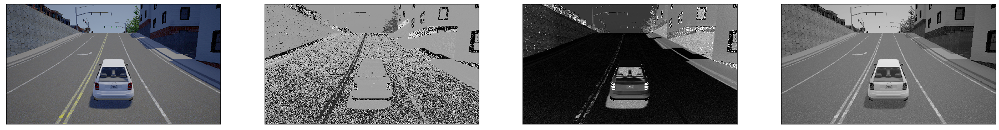

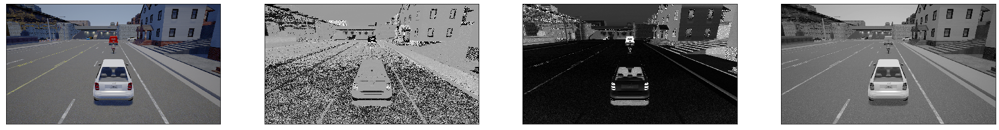

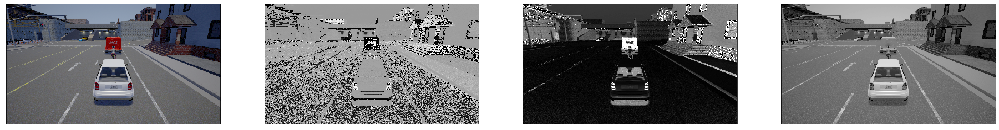

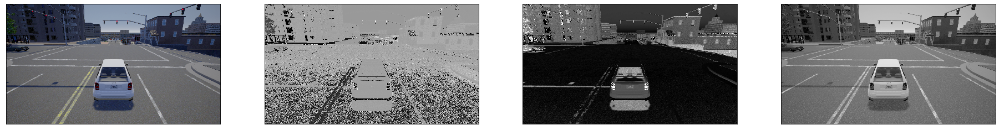

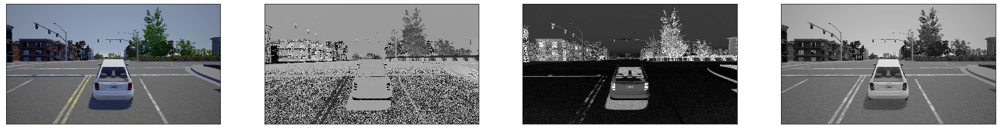

In [0]:
plot_img_grid(test_images, 4)

In [0]:
test_images_v = test_images[3::4]

In [0]:
test_images_v_thresh = [img > 130 for img in test_images_v]

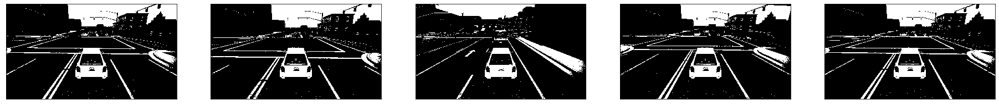

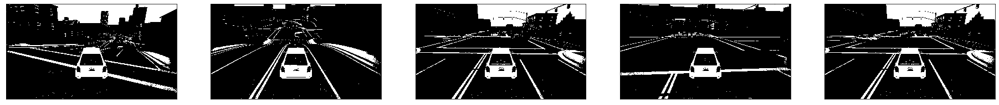

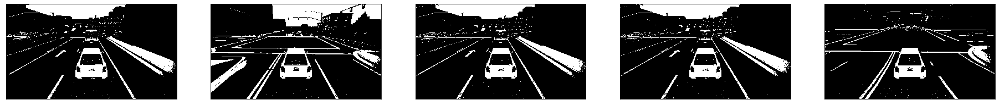

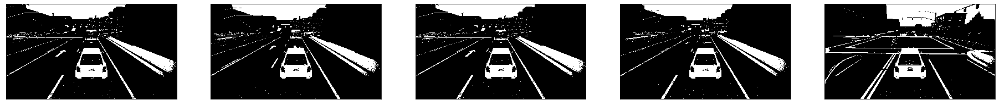

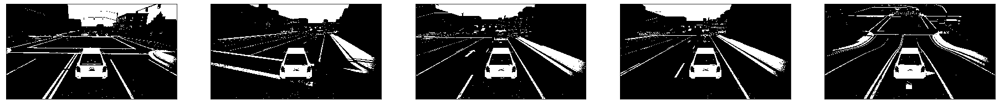

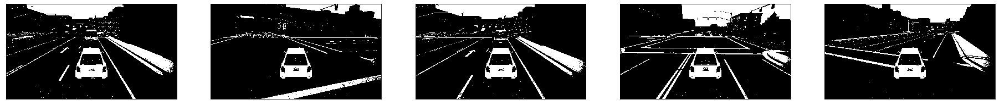

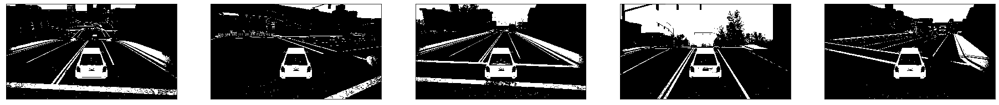

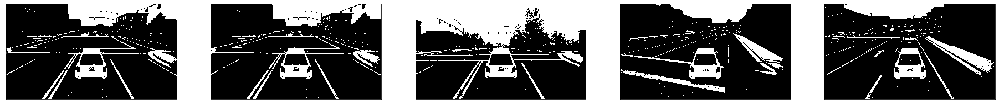

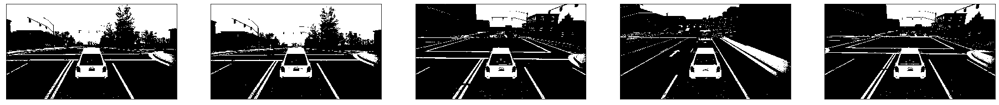

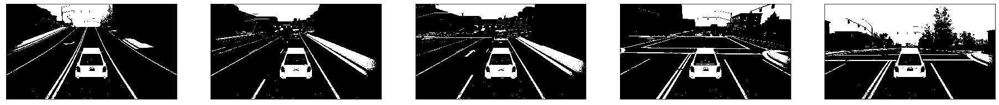

In [0]:
plot_img_grid(test_images_v_thresh,5)

In [0]:
def auto_canny(image, sigma=0.0):
	# compute the median of the single channel pixel intensities
	v = np.median(image)
  # apply automatic Canny edge detection using the computed median
	lower = int(max(0, (1.0 - sigma) * v))
	upper = int(min(255, (1.0 + sigma) * v))
	edged = cv2.Canny(image, lower, upper)
  # return the edged image
	return edged

In [0]:
import pandas as pd

In [0]:
def similarity(line1, line2):
  theta1 = (line1[0][3] - line1[0][1]) / (line1[0][2] - line1[0][0])
  intercept1 = (line1[0][1]) - theta1 * (line1[0][0])
  
  theta2 = (line2[0][3] - line2[0][1]) / (line2[0][2] - line2[0][0])
  intercept2 = (line2[0][1]) - theta2 * (line2[0][0])
  
  return np.abs(intercept1 - intercept2) , np.abs(theta1 - theta2)
    

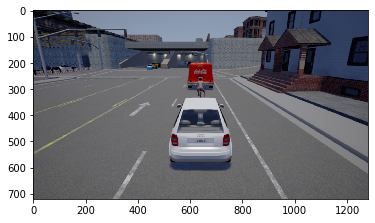

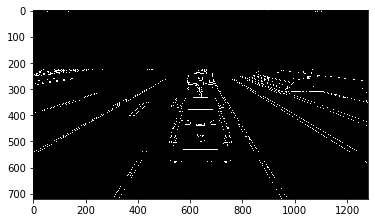

Plotting  319  lines.


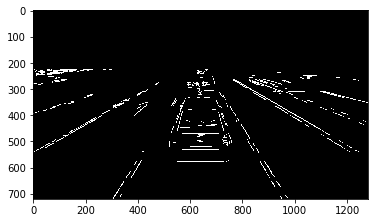

CPU times: user 3.87 s, sys: 3.91 ms, total: 3.87 s
Wall time: 3.87 s


In [0]:
%%time
x = cv2.GaussianBlur(test_images_RGB[2],(3,3),0)
plt.imshow(x); plt.show()
x = cv2.Canny(x,100,200)

for i in range(x.shape[0]): #height
  for j in range(x.shape[1]): #width
    y_ = (x.shape[0] - i)/ x.shape[0] 
    x_ = j
    x[i,j] /= np.sqrt(y_)
x = (x > 50).astype(np.uint8)
plt.imshow(x, cmap='gray'); plt.show()


y = np.zeros_like(x)
lines = cv2.HoughLinesP(image=x, rho=3, theta=np.pi/36.0 ,lines=None, threshold=10 ,minLineLength=10, maxLineGap=3)
print('Plotting ', len(lines), ' lines.')
for i in range(len(lines)):
  for x1,y1,x2,y2 in lines[i]:
      cv2.line(y,(x1,y1),(x2,y2),(255,255,255),2)
plt.imshow(y, cmap='gray'); plt.show()

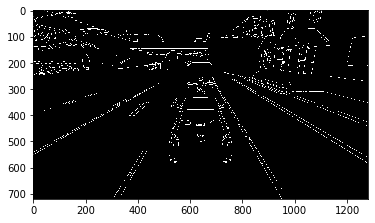

Plotting  13388  lines.


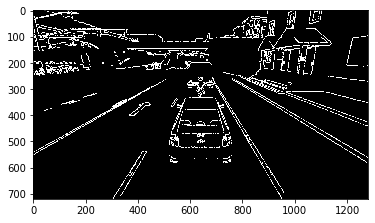

CPU times: user 323 ms, sys: 6.02 ms, total: 329 ms
Wall time: 326 ms


In [0]:
%%time
x = cv2.GaussianBlur(test_images_v[2],(3,3),0)#test_images_v[2]
x = cv2.Canny(x,100,200)

# for i in range(x.shape[0]): #height
#   for j in range(x.shape[1]): #width
#     y_ = (x.shape[0] - i)/ x.shape[0] 
#     x_ = j
#     x[i,j] /= np.sqrt(y_)
#x = (x > np.median(180)).astype(np.uint8)
plt.imshow(x, cmap='gray'); plt.show()


y = np.zeros_like(x)
lines = cv2.HoughLinesP(x,3,np.pi/36.0,3,3,0)
print('Plotting ', len(lines), ' lines.')
for i in range(len(lines)):
  for x1,y1,x2,y2 in lines[i]:
      cv2.line(y,(x1,y1),(x2,y2),(255,255,255),2)
plt.imshow(y, cmap='gray'); plt.show()

In [0]:
def detect_edges(img):
  img_low_pass = cv2.GaussianBlur(img,(3,3),0)
  img_canny = cv2.Canny(img_low_pass,100,200)
  lines = cv2.HoughLinesP(img_canny,3,np.pi/36.0,3,3,0)


  print('Plotting ', len(lines), ' lines.')
  img_lines = np.zeros_like(img_canny)
  for i in range(len(lines)):
    for x1,y1,x2,y2 in lines[i]:
        cv2.line(img_lines,(x1,y1),(x2,y2),(255,255,255),2)
  return img_lines

In [0]:
test_img_with_edges = list(map(detect_edges, test_images_RGB))

In [0]:
output = [img for pair in zip(test_images_RGB, test_img_with_edges) for img in pair ]

In [0]:
plot_img_grid(output, 10)